Simulation of a 2-D Spring lattice  
$F_{(i,j),(k,l)} = \frac{k\Delta z(r - r_0)}{r}$, $\Delta z = z_{(i,j)} - z_{(k,l)}$, $r = \sqrt{\Delta z^2 + d^2}$

$m_{(i,j)} \ddot z_{(i,j)} = -F_{(i-1,j),(i,j)} - F_{(i,j-1),(i,j)} + F_{(i,j),(i+1,j)} + F_{(i,j),(i,j+1)}$  
$z_{(0,:)} = 0$, $z_{(:,0)} = 0$

### To-do:
1. Explore other boundary conditions
2. FFT to determine harmonics of many-mass system
3. State-space of trajectories
4. For many more masses, heat-map rather than manim animation to visualize wave propagation
5. Widget for parameter variation (for heatmap, animations take too long)
6. README
7. Chaos??
8. Examine linear approximations (pre-tensioned versus no tension)

In [3]:
import numpy as np
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
from manim import *
from dataclasses import dataclass
from matplotlib.animation import FuncAnimation
from matplotlib.animation import FFMpegWriter
from IPython.display import HTML

In [40]:
@dataclass
class Params():
    N: int = 9          # Number of masses (+2 for boundary condition) along one dimension
    m: float = 0.2      # Mass of each mass (kg)
    k: float = 10.     # Spring constant (N/m)
    l_0: float = 0.1    # Spring equilibrium distance (m)
    d: float = 1      # In-plane distance between adjacent masses (m)
    t_max: float = 10.     # Total time to simulate (s)
    dt: float = 0.01    # Time step (s)

class SquareDrumhead():
    
    """
    N = number of masses in the system
    m = mass of each mass
    r_0 = spring equilibrium distance
    d = in-plane distance between adjacent masses
    """
    def __init__(self, p: Params):
        self.N = p.N
        self.m = p.m
        self.k = p.k
        self.l_0 = p.l_0
        self.d = p.d
    
    def dy_dt(self, t, z_arr):

        z = z_arr[:self.N**2].reshape((self.N, self.N))
        z_dot = z_arr[self.N**2:]

        z_ddot = np.zeros((self.N, self.N))
        
        #Boundary conditions: fixed ends
        z_ddot[0, :] = 0
        z_ddot[-1, :] = 0
        z_ddot[:, 0] = 0
        z_ddot[:, -1] = 0

        diff_v = z[1:, :] - z[:-1, :]
        diff_h = z[:, 1:] - z[:, :-1]

        dist_v = np.sqrt(self.d**2 + diff_v**2)
        dist_h = np.sqrt(self.d**2 + diff_h**2)

        force_v = self.k * (dist_v - self.l_0) * diff_v / dist_v
        force_h = self.k * (dist_h - self.l_0) * diff_h / dist_h

        F_net_v = force_v[1:, 1:-1] - force_v[:-1, 1:-1]
        F_net_h = force_h[1:-1, 1:] - force_h[1:-1, :-1]

        z_ddot[1:-1, 1:-1] = (F_net_v + F_net_h) / self.m

        z_ddot = z_ddot.flatten()

        return np.concatenate((z_dot, z_ddot))
    
    def solve_ode(self, t_pts, z_0, z_dot_0, 
                  abserr=1.0e-10, relerr=1.0e-10):
        """
        Solve the ODE given initial conditions.
        For now use odeint, but we have the option to switch.
        Specify smaller abserr and relerr to get more precision.
        """
        z_0 = z_0.flatten()
        z_dot_0 = z_dot_0.flatten()

        z_arr = np.concatenate((z_0, z_dot_0)) 
        solution = solve_ivp(self.dy_dt, (t_pts[0], t_pts[-1]), 
                             z_arr, t_eval=t_pts, 
                             atol=abserr, rtol=relerr)
        return solution.y

In [50]:
# Create String instance
params = Params()

def delta_pluck(magnitude=1):
    z_0 = np.zeros((params.N, params.N))
    z_dot_0 = np.zeros((params.N, params.N))
    z_0[params.N // 2, params.N // 2] = magnitude
    return z_0, z_dot_0

def gaussian_pluck(magnitude=1, sigma=5):
    z_0 = np.zeros((params.N, params.N))
    z_dot_0 = np.zeros((params.N, params.N))
    center = params.N // 2
    for i in range(params.N):
        for j in range(params.N):
            r2 = (i - center)**2 + (j - center)**2
            z_0[i, j] = magnitude * np.exp(-r2 / (2 * sigma**2))
    return z_0, z_dot_0

def random_pluck(magnitude=1):
    z_0 = magnitude * np.random.rand(params.N, params.N)
    z_dot_0 = np.zeros((params.N, params.N))
    return z_0, z_dot_0

def init_mode(n_x = 1, n_y = 1, magnitude=1):
    z_0 = np.zeros((params.N, params.N))
    z_dot_0 = np.zeros((params.N, params.N))
    for i in range(params.N):
        for j in range(params.N):
            z_0[i, j] = magnitude * np.sin(n_x * np.pi * i / (params.N - 1)) * np.sin(n_y * np.pi * j / (params.N - 1))
    return z_0, z_dot_0

def solve_system(params, z_0, z_dot_0):
    drumhead = SquareDrumhead(params)

    t_pts = np.arange(0, params.t_max, params.dt)
    solution = drumhead.solve_ode(t_pts, z_0, z_dot_0)
    return t_pts, solution

sigma = 10
z_0, z_dot_0 = init_mode(3, 3, magnitude=1)

t_pts, sol = solve_system(params, z_0, z_dot_0)
z = sol[:params.N**2, :]
z = z.reshape((params.N, params.N, -1))

# Plot results
'''
fig, ax = plt.subplots(params.N**2, 1, figsize=(10, 2*params.N**2))

for i in range(params.N):
    for j in range(params.N):
        ind = i * params.N + j
        ax[ind].plot(t_pts, z[i][j][:])
        ax[ind].set_title(f'Mass {i+1} Displacement Over Time')
        ax[ind].set_xlabel('Time')
        ax[ind].set_ylabel('Displacement')
'''

"\nfig, ax = plt.subplots(params.N**2, 1, figsize=(10, 2*params.N**2))\n\nfor i in range(params.N):\n    for j in range(params.N):\n        ind = i * params.N + j\n        ax[ind].plot(t_pts, z[i][j][:])\n        ax[ind].set_title(f'Mass {i+1} Displacement Over Time')\n        ax[ind].set_xlabel('Time')\n        ax[ind].set_ylabel('Displacement')\n"

In [51]:
# -------------------------------
# Simple spring helper (zig-zag)
# -------------------------------
def spring_polyline(start, end, coils=6, amplitude=0.25, inset=0.35):
    """
    Returns a VMobject shaped like a planar coil spring from start -> end.
    Uses set_points_as_corners for a crisp zig-zag. Compatible with manim v0.19.
    """
    start = np.array(start, dtype=float)
    end   = np.array(end, dtype=float)
    vec = end - start
    L = np.linalg.norm(vec)
    if L < 1e-6:
        return Line(start, end, stroke_width=6)

    # Local frame
    xhat = vec / L
    up = np.array([0.0, 1.0, 0.0])
    yhat = up - np.dot(up, xhat) * xhat
    ny = np.linalg.norm(yhat)
    if ny < 1e-8:
        right = np.array([1.0, 0.0, 0.0])
        yhat = right - np.dot(right, xhat) * xhat
        yhat /= np.linalg.norm(yhat)
    else:
        yhat /= ny

    # Straight end segments + zig-zag body
    Lz = max(L - 2 * inset, 0.0)
    n_verts = 2 * coils + 1
    xs = np.linspace(inset, inset + Lz, n_verts)

    ys = np.zeros_like(xs)
    ys[1::2] =  amplitude
    ys[2::2] = -amplitude
    # Ensure the last zig-zag point is on the center line
    if n_verts > 0:
        ys[-1] = 0

    pts = [start, start + xhat * inset]
    for xi, yi in zip(xs, ys):
        pts.append(start + xhat * xi + yhat * yi)
    pts += [end - xhat * inset, end]

    pts = np.array(pts, dtype=float)

    spring = VMobject()
    spring.set_points_as_corners(pts)
    spring.set_stroke(width=6)
    spring.set_fill(opacity=0)
    return spring

In [52]:
class SquareDrumhead3D(ThreeDScene):
    def construct(self):
        title = Tex(rf"{params.N - 2} x {params.N - 2} Mass-Spring Lattice: $k={params.k}$, $m={params.m}$, $d={params.d}$, $l_0={params.l_0}$", font_size=36)
        title.to_edge(UP).shift(DOWN * 0.5) # Position Top-Left with padding
        self.add_fixed_in_frame_mobjects(title)

        def z_of(t, i, j):
            return np.interp(t, t_pts, z[i, j, :])

        # Layout grid in X (columns) and Y (rows); vertical displacement is Z
        span = 9.0
        x_range = np.linspace(-span / 2, span / 2, params.N)
        y_range = np.linspace(-span / 2, span / 2, params.N)

        # Time tracker drives the animation
        t_tracker = ValueTracker(0.0)

        # Camera for 3D view
        self.set_camera_orientation(phi=65 * DEGREES, theta=-45 * DEGREES)

        # Define a rectangular border (frame) outside the grid; edge masses will be 'ghosts'
        margin = span / params.N
        left = x_range[0]
        right = x_range[-1]
        bottom = y_range[0]
        top = y_range[-1]
        border = Rectangle(width=(right - left), height=(top - bottom)).move_to([(left + right) / 2, (bottom + top) / 2, 0])
        border.set_stroke(width=4, color=WHITE)
        self.add(border)

        # Create interior spheres only (skip outermost grid indices)
        spheres = [[None for _ in range(params.N)] for __ in range(params.N)]
        radius = min(0.12, span / (3.0 * params.N))

        for i in range(params.N):
            for j in range(params.N):
                # Skip boundary masses (ghosts)
                if i == 0 or i == params.N - 1 or j == 0 or j == params.N - 1:
                    spheres[i][j] = None
                    continue

                x = x_range[i]
                y = y_range[j]
                z_pos = z_of(0.0, i, j)
                s = Sphere(radius=radius).move_to([x, y, z_pos]).set_color(BLUE).set_shade_in_3d(True)

                def sph_updater(mob, i=i, j=j, x=x, y=y):
                    zp = z_of(t_tracker.get_value(), i, j)
                    mob.move_to([x, y, zp])

                s.add_updater(sph_updater)
                spheres[i][j] = s
                self.add(s)

        # Springs between interior neighbors only
        springs = []
        for i in range(1, params.N - 1):
            for j in range(1, params.N - 1):
                a = spheres[i][j]
                # right neighbor
                if j + 1 < params.N - 1:
                    b = spheres[i][j + 1]
                    if a is not None and b is not None:
                        spr = spring_polyline(a.get_center(), b.get_center(), coils=4, amplitude=radius * 0.9, inset=radius * 0.5).set_color(WHITE)

                        def spr_update(s, a=a, b=b):
                            s.become(spring_polyline(a.get_center(), b.get_center(), coils=4, amplitude=radius * 0.9, inset=radius * 0.5).set_color(WHITE))

                        spr.add_updater(spr_update)
                        springs.append(spr)
                        self.add(spr)

                # down neighbor
                if i + 1 < params.N - 1:
                    b = spheres[i + 1][j]
                    if a is not None and b is not None:
                        spr2 = spring_polyline(a.get_center(), b.get_center(), coils=4, amplitude=radius * 0.9, inset=radius * 0.5).set_color(WHITE)

                        def spr2_update(s, a=a, b=b):
                            s.become(spring_polyline(a.get_center(), b.get_center(), coils=4, amplitude=radius * 0.9, inset=radius * 0.5).set_color(WHITE))

                        spr2.add_updater(spr2_update)
                        springs.append(spr2)
                        self.add(spr2)

        # Border springs: attach the nearest interior masses to the border frame
        border_springs = []

        # bottom and top attachments (vary i)
        for i in range(1, params.N - 1):
            # bottom-adjacent interior mass (j == 1)
            j_bot = 1
            a = spheres[i][j_bot]
            if a is not None:
                bp = np.array([x_range[i], bottom, 0.0])
                spr = spring_polyline(a.get_center(), bp, coils=3, amplitude=radius * 0.8, inset=radius * 0.4).set_color(WHITE)

                def b_up(s, a=a, bp=bp):
                    s.become(spring_polyline(a.get_center(), bp, coils=3, amplitude=radius * 0.8, inset=radius * 0.4).set_color(WHITE))

                spr.add_updater(b_up)
                border_springs.append(spr)
                self.add(spr)

            # top-adjacent interior mass (j == N-2)
            j_top = params.N - 2
            a = spheres[i][j_top]
            if a is not None:
                bp = np.array([x_range[i], top, 0.0])
                spr = spring_polyline(a.get_center(), bp, coils=3, amplitude=radius * 0.8, inset=radius * 0.4).set_color(WHITE)

                def t_up(s, a=a, bp=bp):
                    s.become(spring_polyline(a.get_center(), bp, coils=3, amplitude=radius * 0.8, inset=radius * 0.4).set_color(WHITE))

                spr.add_updater(t_up)
                border_springs.append(spr)
                self.add(spr)

        # left and right attachments (vary j)
        for j in range(1, params.N - 1):
            # left-adjacent interior mass (i == 1)
            i_left = 1
            a = spheres[i_left][j]
            if a is not None:
                bp = np.array([left, y_range[j], 0.0])
                spr = spring_polyline(a.get_center(), bp, coils=3, amplitude=radius * 0.8, inset=radius * 0.4).set_color(WHITE)

                def l_up(s, a=a, bp=bp):
                    s.become(spring_polyline(a.get_center(), bp, coils=3, amplitude=radius * 0.8, inset=radius * 0.4).set_color(WHITE))

                spr.add_updater(l_up)
                border_springs.append(spr)
                self.add(spr)

            # right-adjacent interior mass (i == N-2)
            i_right = params.N - 2
            a = spheres[i_right][j]
            if a is not None:
                bp = np.array([right, y_range[j], 0.0])
                spr = spring_polyline(a.get_center(), bp, coils=3, amplitude=radius * 0.5, inset=radius * 1.5).set_color(WHITE)

                def r_up(s, a=a, bp=bp):
                    s.become(spring_polyline(a.get_center(), bp, coils=3, amplitude=radius * 0.8, inset=radius * 0.4).set_color(WHITE))

                spr.add_updater(r_up)
                border_springs.append(spr)
                self.add(spr)

        # Animate: advance the tracker from 0 -> T_total (real-time run)
        self.play(t_tracker.animate.set_value(params.t_max), run_time=params.t_max, rate_func=linear)
        self.wait(0.5)

In [53]:
%manim -pql SquareDrumhead3D

Manim Community v0.19.1

KeyboardInterrupt: 

[12/09/25 23:21:24] INFO     Animation.save using <class 'matplotlib.animation.FFMpegWriter'>     ]8;id=81865;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py\animation.py]8;;\:]8;id=845300;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py#1076\1076]8;;\

                    INFO     MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec         ]8;id=398341;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py\animation.py]8;;\:]8;id=409589;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py#319\319]8;;\
                             rawvideo -s 900x900 -pix_fmt rgba -framerate 100 -loglevel error -i                   
                             pipe: -vcodec h264 -pix_fmt yuv420p -b 1800k -metadata                                
                             artist=tony-yuhos -y drumhead_heatmap.mp4                                             

[12/09/25 23:30:41] INFO     Animation.save using <class 'matplotlib.animation.HTMLWriter'>       ]8;id=248196;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py\animation.py]8;;\:]8;id=700193;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py#1076\1076]8;;\

[12/09/25 23:31:54] WARNING  Animation size has reached 21002940 bytes, exceeding the limit of     ]8;id=522162;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py\animation.py]8;;\:]8;id=857203;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py#796\796]8;;\
                             20971520.0. If you're sure you want a larger animation embedded, set                  
                             the animation.embed_limit rc parameter to a larger value (in MB).                     
                             This and further frames will be dropped.                                              

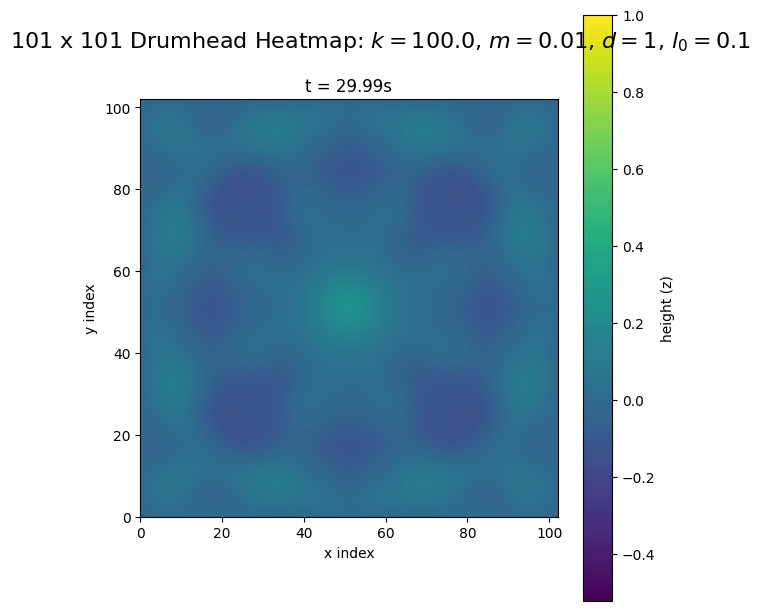

In [11]:
# Animated heatmap of the drumhead (x,y grid) evolving in time


# Expect `z` (N x N x T) and `t_pts` to be defined by earlier cells
T = z.shape[2]
vmin = float(np.min(z))
vmax = float(np.max(z))

fig, ax = plt.subplots(figsize=(6,6), layout='constrained')

fig.suptitle(fr"{params.N - 2} x {params.N - 2} Drumhead Heatmap: $k={params.k}$, $m={params.m}$, $d={params.d}$, $l_0={params.l_0}$", fontsize=16, y=0.96)

im = ax.imshow(z[:, :, 0], origin='lower', vmin=vmin, vmax=vmax, cmap='viridis',
               extent=[0, params.N-1, 0, params.N-1], interpolation='nearest')
ax.set_xlabel('x index')
ax.set_ylabel('y index')
cbar = fig.colorbar(im, ax=ax)
cbar.set_label('height (z)')
title = ax.set_title(f't = {t_pts[0]:.2f}s')

def update(frame):
    im.set_data(z[:, :, frame])
    title.set_text(f't = {t_pts[frame]:.2f}s')
    return (im,)

anim = FuncAnimation(fig, update, frames=range(T), interval=params.dt*1000, blit=False)

# Save as MP4 using ffmpeg
fps_writer = int(round(1.0 / params.dt))
writer = FFMpegWriter(fps=fps_writer, metadata=dict(artist='tony-yuhos'), bitrate=1800)
anim.save('drumhead_heatmap.mp4', writer=writer, dpi=150)

# Display inline as JS animation (works in modern Jupyter environments)
HTML(anim.to_jshtml())

[12/07/25 21:51:19] INFO     Animation.save using <class 'matplotlib.animation.FFMpegWriter'>     ]8;id=428751;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py\animation.py]8;;\:]8;id=703915;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py#1076\1076]8;;\

                    INFO     MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec         ]8;id=893689;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py\animation.py]8;;\:]8;id=297756;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py#319\319]8;;\
                             rawvideo -s 900x900 -pix_fmt rgba -framerate 100 -loglevel error -i                   
                             pipe: -vcodec h264 -pix_fmt yuv420p -b 1800k -metadata                                
                             artist=tony-yuhos -y drumhead_heatmap_log.mp4                                         

[12/07/25 22:04:59] INFO     Animation.save using <class 'matplotlib.animation.HTMLWriter'>       ]8;id=651728;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py\animation.py]8;;\:]8;id=857180;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py#1076\1076]8;;\

[12/07/25 22:05:39] WARNING  Animation size has reached 20981393 bytes, exceeding the limit of     ]8;id=217090;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py\animation.py]8;;\:]8;id=699906;file://c:\Users\antho\anaconda3\envs\5300\Lib\site-packages\matplotlib\animation.py#796\796]8;;\
                             20971520.0. If you're sure you want a larger animation embedded, set                  
                             the animation.embed_limit rc parameter to a larger value (in MB).                     
                             This and further frames will be dropped.                                              

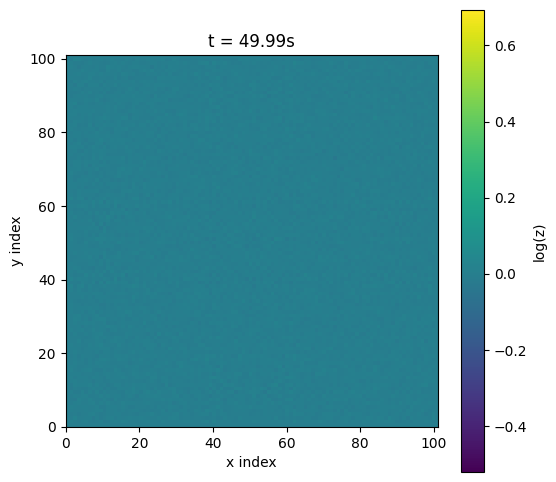

In [40]:
# Animated heatmap of the drumhead (x,y grid) evolving in time


# Expect `z` (N x N x T) and `t_pts` to be defined by earlier cells
T = z.shape[2]
log_z = np.log1p(np.abs(z)) * np.sign(z)
vmin = float(np.min(log_z))
vmax = float(np.max(log_z))

fig, ax = plt.subplots(figsize=(6,6))
im = ax.imshow(log_z[:, :, 0], origin='lower', vmin=vmin, vmax=vmax, cmap='viridis',
               extent=[0, params.N-1, 0, params.N-1], interpolation='nearest')
ax.set_xlabel('x index')
ax.set_ylabel('y index')
cbar = fig.colorbar(im, ax=ax)
cbar.set_label('log(z)')
title = ax.set_title(f't = {t_pts[0]:.2f}s')

def update(frame):
    im.set_data(log_z[:, :, frame])
    title.set_text(f't = {t_pts[frame]:.2f}s')
    return (im,)

anim = FuncAnimation(fig, update, frames=range(T), interval=params.dt*1000, blit=False)

# Save as MP4 using ffmpeg
fps_writer = int(round(1.0 / params.dt))
writer = FFMpegWriter(fps=fps_writer, metadata=dict(artist='tony-yuhos'), bitrate=1800)
anim.save('drumhead_heatmap_log.mp4', writer=writer, dpi=150)

# Display inline as JS animation (works in modern Jupyter environments)
HTML(anim.to_jshtml())

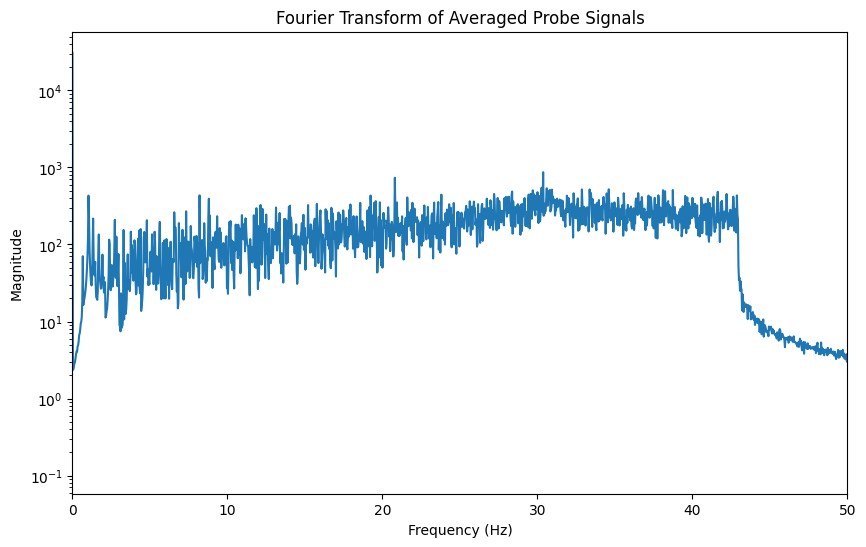

In [37]:
# Identify peaks in the FFT

# Calculate harmonics using probes at corner, 1/3, and center masses

probe_indices = [(params.N // 2, params.N // 2), (params.N // 3, params.N // 2), (params.N // 4, params.N // 3), (2*params.N // 7, 3*params.N // 11)]

# Fourier Transform of GMS
freqs = np.fft.rfftfreq(len(t_pts), d=params.dt)

avg_spectrum = np.zeros(len(freqs))

for idx in probe_indices:
    probe_signal = z[*idx, :]
    
    # Fourier Transform
    probe_fft = np.abs(np.fft.rfft(probe_signal))
    
    avg_spectrum += probe_fft

avg_spectrum /= len(probe_indices)

fig_mag, ax_mag = plt.subplots(figsize=(10, 6))
ax_mag.semilogy(freqs, avg_spectrum)
ax_mag.set_title('Fourier Transform of Averaged Probe Signals')
ax_mag.set_xlabel('Frequency (Hz)')
ax_mag.set_ylabel('Magnitude')
ax_mag.set_xlim(0, 50)

plt.show()

In [39]:
# Determine peak frequencies
from scipy.signal import find_peaks

peaks, _ = find_peaks(avg_spectrum, height=1e1)

peak_freqs = freqs[peaks]
peak_amps = avg_spectrum[peaks]

# Theoretical fundamental frequency
k_eff = params.k * (1 - params.l_0 / params.d)
f1 = np.sqrt(2)/np.pi * np.sqrt(params.k / params.m) * np.sin(np.pi / (2 * (params.N - 1)))

# Print peak frequencies and amplitudes
if len(peak_freqs) > 0:
    print(f"Fundamental Frequency (f1): {f1:.4f} Hz")
    print("-" * 40)
    print(f"{'Peak (Hz)':<12} | {'Amplitude':<10} | {'Ratio (f/f1)':<12}")
    print("-" * 40)

    for f, amp in zip(peak_freqs, peak_amps):
        ratio = f / f1

        print(f"{f:<12.4f} | {amp:<10.4f} | {ratio:<12.4f}")
else:
    print("No peaks found!")

Fundamental Frequency (f1): 0.6932 Hz
----------------------------------------
Peak (Hz)    | Amplitude  | Ratio (f/f1)
----------------------------------------
0.6667       | 70.5004    | 0.9617      
1.0333       | 431.1917   | 1.4906      
1.3333       | 217.3314   | 1.9234      
1.4667       | 59.5820    | 2.1157      
1.7000       | 134.8747   | 2.4523      
1.9333       | 73.8757    | 2.7889      
2.0000       | 38.1286    | 2.8851      
2.1000       | 32.3634    | 3.0294      
2.3667       | 115.5902   | 3.4140      
2.5333       | 54.1270    | 3.6545      
2.7333       | 209.0887   | 3.9430      
2.8333       | 126.3724   | 4.0872      
2.9667       | 75.1458    | 4.2796      
3.1333       | 23.1642    | 4.5200      
3.3000       | 154.3600   | 4.7604      
3.3667       | 57.9042    | 4.8566      
3.5667       | 74.3035    | 5.1451      
3.6333       | 34.0800    | 5.2413      
3.7667       | 146.6924   | 5.4336      
3.8333       | 98.3376    | 5.5298      
4.0000       | 113.